# EigenBeat

An Exploration of PCA on Music by Andy Yan

## Purpose

The purpose of this notebook is to explore the usage of PCA, Principal Component Analysis, to construct an approximate tune using the eigenvectors of tracks taken from: https://www.looperman.com/.

## Background

PCA is a useful tool that can be applied for facial recognition purposes. The central idea goes as follows: given a set of data points in some n-dimensional space, we attempt to find the direction of the vector that either

1. Minimizes the size of the orthogonal projection of each datapoint onto the vector.
2. Maximizes the variance of the distance between the points of the orthogonal projection and the origin.

The intuition behind this is to find a vector that captures the variance of the data the best. You can read more here: http://cs229.stanford.edu/notes/cs229-notes10.pdf.

In order to use this concept in facial recognition, imagine each data point represents a face. For example, a data point, x, could represent the grayscale values of every pixel in an image, where $x_1$ is the grayscale value of the first pixel, $x_2$ is the grayscale value of the second pixel, etc.

Next, assume we have found a vector that best captures the variance of the data set, which has 4 data points or 4 faces.
<img src="img/pca.png" width="400px">
Given the directionality of the vector, imagine we have to compare the similarity between two faces. In order to do this, we find the distance of the points between the orthogonal projection of the two faces onto the vector instead of finding the distance between the data points directly. By doing this, we are essentially stating that the difference between two faces is not the difference in every pixel but rather the difference in some principal component represented by the vector. Therefore, random differences are not taken into account such as lighting if the principal component captured represents details of the face rather than details of the photo.

To get the principle vector, we simply get the eigenvector with the largest eigenvalue of the covariance matrix of the data set. There is a proof to justify this, but the intuition is that the eigenvector with the largest eigenvalue of the covariance matrix is the direction that has the maximum variance in the data set.

<img src="img/eigenface.png" width="300px">
If we reconstruct an image using a point that sits on the vector, we extract what is called an eigenface, which, as shown above, has the basic shape of a human.

## Idea

Given the ability to construct a figure that captures the structure of a human face in images (the eigenface), can we apply this idea to music, constructing a sort of beat that captures the basic structure of a song? Specifically, I limit the scope of songs to just be either hip-hop drum tracks with BPM between 115 and 130 to try to capture the structure of a hip hop song or variety songs in C key with exactly 130BPM.

In [44]:
import numpy as np
import scipy.io.wavfile as wavfile
import matplotlib.pyplot as plt
import os
import IPython.display as ipd
from scipy.signal import lfilter
from sklearn import decomposition

SECONDS_PER_SAMPLE = 5 #The amount of seconds to excerpt from a song.
SAMPLING_RATE = 44100 #The rate that a song is sampled at.

## Data Pre-processing

From the website www.looperman.com, I took soundtracks categorized under drum and hiphop with similar BPM (115-130) for one dataset.

I also take soundtracks under different genres with the exact same BPM and key (C).

In order to begin processing these two categories of data, I converted all audio files to floating point arrays representing amplitude of samples sampled at the rate of 44100Hz. These datapoints therefore have extremely high dimentionality. Because each track is around 8s long, we also split the tracks into smaller components of time length SECONDS_PER_SAMPLE.

In [45]:
hiphop_samples = []
variety_samples = []

def data_to_arr(directory, samples):
    for filename in os.listdir(directory):
        if ".wav" in filename:
            a = wavfile.read(directory + "/" + filename)
            assert(a[0] == SAMPLING_RATE)
            vals = np.array(a[1], dtype=float)[:,0]
            #maxAmp = max(vals)
            plt.show()
            i = 0
            samples.append(vals[round(i):round(i+SAMPLING_RATE*SECONDS_PER_SAMPLE)])#/maxAmp * 30000)
            i += SAMPLING_RATE*SECONDS_PER_SAMPLE

data_to_arr("data/hip-hop-drum", hiphop_samples)
data_to_arr("data/variety-samebpm", variety_samples)
hiphop_samples = np.array(hiphop_samples)
variety_samples = np.array(variety_samples)
print("Hiphop samples:", hiphop_samples.shape)
print("Variety samples:", variety_samples.shape)

/anaconda3/lib/python3.6/site-packages/scipy/io/wavfile.py:273: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)


Hiphop samples: (29,)
Variety samples: (14,)


Here are the some of the samples from the two sets.

Hiphop samples:


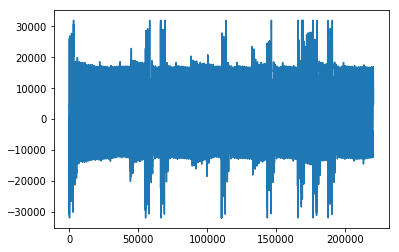

Variety samples:


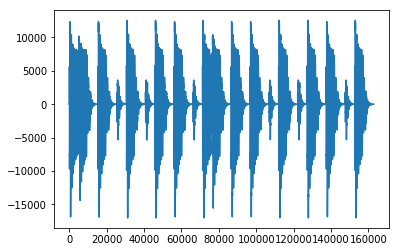

In [46]:
print("Hiphop samples:")
plt.plot(hiphop_samples[0])
plt.show()
print("Variety samples:")
plt.plot(variety_samples[1])
plt.show()

By converting these audio files into a floating point representation, there is a possibility of losing quality from the original wav file. In order to evaluate the lossiness of representing the data in this format, we can reconstruct the processed vectors into wav files and compare it to the original.

As shown below, there is little to no lossiness in deconstruction and reconstructing the WAV file.

In [47]:
ipd.Audio('data/hip-hop-drum/1.wav')

In [48]:
wavfile.write('generated/sample.wav', SAMPLING_RATE, np.asarray(hiphop_samples[1], dtype=np.int16))
ipd.Audio('generated/sample.wav')

Generally, we would normalize the data by setting the mean of the data to be 0 and setting the covariance to 1 before using PCA. This would ensure that our eigenvectors can represent the appropriate shape of our data and to prevent certain features to be treated at different scales.

However, because we are analyzing audio files, the mean should be around 0, so we could possibly skip that step. We could also skip the step of setting the covariance to 1 since all samples of audio files in our data are on the same scale. In optional processing, we set the mean to 0 and set the covariance to 1 to experiment with doing it anyways.

## Optional Preprocessing

Because some of the samples could be different lengths due to some error with SECONDS_PER_SAMPLE, we trim the samples to ensure they are all of the same length.
Then, we can also subtract the mean wave to experiment and set the variance to 0 as well.

In [49]:
trimmed_hiphop = []
for i in range(len(hiphop_samples)):
    trimmed_hiphop.append(hiphop_samples[i][:150000])
    
trimmed_variety = []
for i in range(len(variety_samples)):
    trimmed_variety.append(variety_samples[i][:150000])

In [50]:
zero_mean_hiphop = trimmed_hiphop - np.apply_along_axis(np.mean, 0, trimmed_hiphop)
zero_mean_variety = trimmed_variety - np.apply_along_axis(np.mean, 0, trimmed_variety)

In [51]:
unit_var_hiphop = []
for row in zero_mean_hiphop:
    unit_var_hiphop.append(row/row.std(axis=0))
    
unit_var_variety = []
for row in zero_mean_variety:
    unit_var_variety.append(row/row.std(axis=0))

## PCA Modeling

Now we will get to actually creating out model. We will investigate as follows:
1. Unnormalized hiphop data & variety data
2. 0 mean hiphop data & variety data
3. 0 mean unit variance hiphop data & variety data

The PCA algorithm comes from sklearn's decomposition. We are interested in the eigenvectors with the highest eigenvalues. Sklearn's PCA picks the n eigenvectors with the highest eigenvalues, where n is n_components. Below we create out model and plot the mean of the samples.

### 1. Unnormalized hiphop data & variety data

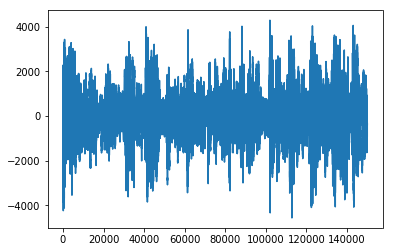

In [52]:
hiphop_pca = decomposition.PCA(n_components=10)
hiphop_pca.fit(trimmed_hiphop)
plt.plot(hiphop_pca.mean_)
plt.show()
wavfile.write('generated/avg.wav', SAMPLING_RATE, np.asarray(hiphop_pca.mean_, dtype=np.int16))
ipd.Audio('generated/avg.wav')

Clearly the average is just a jumble of nonsense, so we do not capture anything about the general structure of a song. However, let's take a look at the three eigenvectors associated with the largest eigenvalues we obtain from using PCA.

In [10]:
for i in range(len(hiphop_pca.components_)):
    arr = hiphop_pca.components_[i] * hiphop_pca.singular_values_[i]
    vals = np.asarray(arr/max(arr) * 30000, dtype=np.int16)
    """
    n = 15  # the larger n is, the smoother curve will be
    b = [1.0 / n] * n
    a = 1
    yy = lfilter(b,a,vals)
    #vals = yy
    """
    wavfile.write('generated/hiphop_eigen' + str(i) + '.wav', SAMPLING_RATE, np.asarray(np.concatenate([vals, vals, vals, vals]), dtype=np.int16))

In [11]:
ipd.Audio('generated/hiphop_eigen0.wav')

In [12]:
ipd.Audio('generated/hiphop_eigen1.wav')

In [13]:
ipd.Audio('generated/hiphop_eigen2.wav')

In our eigenvectors, we capture some structure of the hip hop tracks. These three eigenvectors represent the causes of the greatest variance in the data. However, there is a flaw in that they actually sound like individual tracks that are in the data set. Thus, instead of capturing the real structure of a hip hop track, PCA finds that certain tracks themselves in the dataset cause the greatest variance. This could be due to a lack of training data or that the tracks represented by the eigenvectors have too great a variance. Let's see what happens with the variety data to get a better picture of this.

In [53]:
variety_pca = decomposition.PCA(n_components=10)
variety_pca.fit(trimmed_variety)

for i in range(len(variety_pca.components_)):
    arr = variety_pca.components_[i] * variety_pca.singular_values_[i]
    vals = np.asarray(arr/max(arr) * 30000, dtype=np.int16)
    wavfile.write('generated/variety_eigen' + str(i) + '.wav', SAMPLING_RATE, np.asarray(np.concatenate([vals, vals, vals, vals]), dtype=np.int16))

In [54]:
ipd.Audio('generated/variety_eigen0.wav')

In [55]:
ipd.Audio('generated/variety_eigen1.wav')

In [56]:
ipd.Audio('generated/variety_eigen2.wav')

The first two eigenvectors have some background noise but primarily you can hear that eigen0 and eigen1 have distinct bass/snare patterns and eigen2 focuses on some tune that appears as noise in eigen0 and eigen1. Clearly the snare, base, and tune exactly match one data file each though.

### 2. 0 mean hiphop data & variety data

In [18]:
zero_mean_hiphop_pca = decomposition.PCA(n_components=10)
zero_mean_hiphop_pca.fit(zero_mean_hiphop)

for i in range(len(zero_mean_hiphop_pca.components_)):
    arr = zero_mean_hiphop_pca.components_[i] * zero_mean_hiphop_pca.singular_values_[i]
    vals = np.asarray(arr/max(arr) * 30000, dtype=np.int16)
    wavfile.write('generated/zero_mean_hiphop_eigen' + str(i) + '.wav', SAMPLING_RATE, np.asarray(np.concatenate([vals, vals, vals, vals]), dtype=np.int16))

In [19]:
ipd.Audio('generated/zero_mean_hiphop_eigen0.wav')

In [20]:
ipd.Audio('generated/zero_mean_hiphop_eigen1.wav')

In [21]:
ipd.Audio('generated/zero_mean_hiphop_eigen2.wav')

In [22]:
zero_mean_variety_pca = decomposition.PCA(n_components=10)
zero_mean_variety_pca.fit(zero_mean_variety)

for i in range(len(zero_mean_variety_pca.components_)):
    arr = zero_mean_variety_pca.components_[i] * zero_mean_variety_pca.singular_values_[i]
    vals = np.asarray(arr/max(arr) * 30000, dtype=np.int16)
    wavfile.write('generated/zero_mean_variety_eigen' + str(i) + '.wav', SAMPLING_RATE, np.asarray(np.concatenate([vals, vals, vals, vals]), dtype=np.int16))

In [23]:
ipd.Audio('generated/zero_mean_variety_eigen0.wav')

In [24]:
ipd.Audio('generated/zero_mean_variety_eigen1.wav')

In [25]:
ipd.Audio('generated/zero_mean_variety_eigen2.wav')

Zeroing the mean appears to make little to no difference, which makes sense since we are using audio signals, which oscilate around 0.

### 3. 0 mean unit variance hiphop data & variety data

In [26]:
unit_hiphop_pca = decomposition.PCA(n_components=10)
unit_hiphop_pca.fit(unit_var_hiphop)

for i in range(len(unit_hiphop_pca.components_)):
    arr = unit_hiphop_pca.components_[i] * unit_hiphop_pca.singular_values_[i]
    vals = np.asarray(arr/max(arr) * 20000, dtype=np.int16)
    wavfile.write('generated/unit_var_hiphop_eigen' + str(i) + '.wav', SAMPLING_RATE, np.asarray(np.concatenate([vals, vals, vals, vals]), dtype=np.int16))

In [27]:
ipd.Audio('generated/unit_var_hiphop_eigen0.wav')

In [28]:
ipd.Audio('generated/unit_var_hiphop_eigen1.wav')

In [29]:
ipd.Audio('generated/unit_var_hiphop_eigen8.wav')

In [30]:
unit_variety_pca = decomposition.PCA(n_components=10)
unit_variety_pca.fit(unit_var_variety)
for i in range(len(unit_variety_pca.components_)):
    arr = unit_variety_pca.components_[i] * unit_variety_pca.singular_values_[i]
    vals = np.asarray(arr/max(arr) * 20000, dtype=np.int16)
    wavfile.write('generated/unit_var_variety_eigen' + str(i) + '.wav', SAMPLING_RATE, np.asarray(np.concatenate([vals, vals, vals, vals]), dtype=np.int16))

In [31]:
ipd.Audio('generated/unit_var_variety_eigen0.wav')

In [32]:
ipd.Audio('generated/unit_var_variety_eigen1.wav')

In [58]:
ipd.Audio('generated/unit_var_variety_eigen2.wav')

In [34]:
ipd.Audio('generated/unit_var_variety_eigen6.wav')

Now when we listen to eigen0, eigen1, and eigen2, we notice that eigen1 has the tune from before that was present in all three eigenvectors. The tune is actually less present now in eigen0 and eigen2 because we have scaled the data so the tune has a smaller weight in the dataset.

## Getting the EigenBeat for a Track
Although we cannot capture what we want in an eigenvector with this small of a dataset, for example a consistent drum beat that's common in 130BPM songs, we can still try to construct eigenbeats from the orthogonal projection of a track onto an n vector basis. We will use this equation to find this projection onto a 10 vector basis. Here f is the signal and $v_i$ is a vector in the basis.

<img src="img/projection.png" width="300px">

In the future, I can improve my dataset by finding more and more closely related songs for my dataset to capture these patterns.

In [59]:
hiphop_track = trimmed_hiphop[2]

In [60]:
vals = np.asarray(hiphop_track, dtype=np.int16)
wavfile.write('generated/testtrack.wav', SAMPLING_RATE, np.asarray(vals, dtype=np.int16))
print("Original: ")
ipd.Audio('generated/testtrack.wav')

Original: 


In [37]:
proj = np.zeros(len(vals))
for v in unit_hiphop_pca.components_:
    proj += (np.dot(vals, v))*v
    
wavfile.write('generated/testtrackproj.wav', SAMPLING_RATE, np.asarray(proj, dtype=np.int16))

In [38]:
print("EigenBeat: ")
ipd.Audio('generated/testtrackproj.wav')

EigenBeat: 


In [39]:
variety_track = trimmed_variety[1]

In [40]:
vals = np.asarray(variety_track, dtype=np.int16)
wavfile.write('generated/testtrack.wav', SAMPLING_RATE, np.asarray(vals, dtype=np.int16))
print("Original: ")
ipd.Audio('generated/testtrack.wav')

Original: 


In [41]:
proj = np.zeros(len(vals))
for v in unit_variety_pca.components_:
    proj += (np.dot(vals, v))*v
    
wavfile.write('generated/testtrackproj.wav', SAMPLING_RATE, np.asarray(proj, dtype=np.int16))

In [42]:
print("EigenBeat: ")
ipd.Audio('generated/testtrackproj.wav')

EigenBeat: 


## Conclusion

The eigenbeats are located on the line in the image shown below, where each point is one of our training samples. When we find the projection, we follow the dotted line down to the line, and retrieve an approximation of our original sample. For both hiphop and variety categories, this works very well and we can notice that when we reconstruct our songs using the eigenvectors, the songs closely resemble the originals.

<img src="img/pca.png" width="400px">

A representation of blending of songs is produced in the eigenbeat above in variety music. (Also it doesn't sound that bad since every song in the variety category is 130BPM! It is a little haunting though). This is because the projected point is also close to other sample tracks in our data set, thus sounding like the original track is layered with other sample tracks. Furthermore, there is a noticable difference between using data with unit variance and data without it. This is because some tracks actually have generally lower amplitude than others and are overwhelmed by other songs. For example, trimmed_hiphop[2] has a softer snare beat. The projection of this beat onto the PCA trained without unit variance will be silent whereas the projection of this beat onto PCA with unit variance will resemble the original more.


So now you know what an EigenBeat sounds like! Cool, huh?
If you want to reach out to me you can find my website on https://andylc.github.io and you can also check out my other projects on https://github.com/AndyLc.